In [62]:
import os
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import cv2
import math

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torchaudio.transforms import TimeMasking, FrequencyMasking
from torchvision import models

import librosa
import scipy.signal as signal
import pyloudnorm as pyln
import IPython.display as ipd
from IPython.display import display
import librosa.display as lid

from tqdm.auto import tqdm
import random
from typing import Tuple, List, Dict

In [47]:
DATA_PATH = "./birdclef-2025"

In [48]:
class CFG:
    seed: int = 42

    pretrained: bool = True
    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    batch_size: int = 32
    in_channels = 1
    target_shape = (256, 256)
    
    # Audio duration, sample rate, and length
    duration: int = 15 # second
    sample_rate: int = 32000
    audio_len: int = duration * sample_rate
    
    # STFT parameters
    nfft: int = 1024
    window: int = 1024
    hop_length: int = 512
    fmin: int = 20
    fmax: int = 16000
    n_mels: int = 128
    
    # Number of epochs, model name
    epochs: int = 25
    preset: str = 'efficientnetv2_b0'
    
    # Data augmentation parameters
    augment=True

    # Class Labels for BirdCLEF 25
    train_csv = os.path.join(DATA_PATH, 'train.csv')
    train_audio = os.path.join(DATA_PATH, 'train_audio/')
    taxonomy_csv = os.path.join(DATA_PATH, 'taxonomy.csv')
    test_soundscapes = os.path.join(DATA_PATH, 'test_soundscapes/')
    train_soundscapes = os.path.join(DATA_PATH, 'train_soundscapes/')
    submission_csv = os.path.join(DATA_PATH, 'sample_submission.csv')

    class_names: List[str] = sorted(os.listdir(train_audio))
    num_classes: int = len(class_names)
    class_labels: List[int] = list(range(num_classes))
    label2name: Dict[int, str] = dict(zip(class_labels, class_names))
    name2label: Dict[str, int] = {v:k for k,v in label2name.items()}

In [49]:
train_df = pd.read_csv(CFG.train_csv)
train_df['filepath'] = CFG.train_audio + train_df['filename']

train_df.head()

,primary_label,secondary_labels,type,filename,collection,rating,url,latitude,longitude,scientific_name,common_name,author,license,filepath
0,1139490,[''],[''],1139490/CSA36385.ogg,CSA,0.0,http://colecciones.humboldt.org.co/rec/sonidos...,7.3206,-73.7128,Ragoniella pulchella,Ragoniella pulchella,Fabio A. Sarria-S,cc-by-nc-sa 4.0,./birdclef-2025/train_audio/1139490/CSA36385.ogg
1,1139490,[''],[''],1139490/CSA36389.ogg,CSA,0.0,http://colecciones.humboldt.org.co/rec/sonidos...,7.3206,-73.7128,Ragoniella pulchella,Ragoniella pulchella,Fabio A. Sarria-S,cc-by-nc-sa 4.0,./birdclef-2025/train_audio/1139490/CSA36389.ogg
2,1192948,[''],[''],1192948/CSA36358.ogg,CSA,0.0,http://colecciones.humboldt.org.co/rec/sonidos...,7.3791,-73.7313,Oxyprora surinamensis,Oxyprora surinamensis,Fabio A. Sarria-S,cc-by-nc-sa 4.0,./birdclef-2025/train_audio/1192948/CSA36358.ogg
3,1192948,[''],[''],1192948/CSA36366.ogg,CSA,0.0,http://colecciones.humboldt.org.co/rec/sonidos...,7.2800,-73.8582,Oxyprora surinamensis,Oxyprora surinamensis,Fabio A. Sarria-S,cc-by-nc-sa 4.0,./birdclef-2025/train_audio/1192948/CSA36366.ogg
4,1192948,[''],[''],1192948/CSA36373.ogg,CSA,0.0,http://colecciones.humboldt.org.co/rec/sonidos...,7.3791,-73.7313,Oxyprora surinamensis,Oxyprora surinamensis,Fabio A. Sarria-S,cc-by-nc-sa 4.0,./birdclef-2025/train_audio/1192948/CSA36373.ogg


#### Util functions

In [50]:
cmap = matplotlib.cm.get_cmap('coolwarm')

def bandpass_filter(y, sr, lowcut=500, highcut=10000, order=8):
    sos = signal.butter(order, [lowcut, highcut], btype='band', fs=sr, output='sos')
    filtered = signal.sosfilt(sos, y)
    return filtered


def load_audio(filepath: str, sr: int | None = None) -> Tuple[np.ndarray, int]:
    audio, sr = librosa.load(filepath, sr=sr)
    return audio, sr


def get_spectrogram(audio: np.ndarray) -> np.ndarray:
    spec = librosa.feature.melspectrogram(y=audio, 
                                   sr=CFG.sample_rate, 
                                   n_mels=CFG.n_mels,
                                   n_fft=CFG.nfft,
                                   hop_length=CFG.hop_length,
                                   win_length=CFG.window,
                                   fmax=CFG.fmax,
                                   fmin=CFG.fmin,
                                   )
    spec = librosa.power_to_db(spec, ref=1.0)
    min_ = spec.min()
    max_ = spec.max()
    if max_ != min_:
        spec = (spec - min_)/(max_ - min_)
    return spec


def display_audio(row: pd.DataFrame, LUFS: float = 1, filtering: bool = False, seconds: int = -1) -> None:
    caption = f'Id: {row["filename"]} | Name: {row["common_name"]} | Sci.Name: {row["scientific_name"]} | Rating: {row["rating"]}'

    audio, sr = load_audio(row["filepath"])
    if seconds != -1:
        audio = audio[:seconds * CFG.sample_rate]
    
    if LUFS != 1:
        meter = pyln.Meter(sr)
        loudness = meter.integrated_loudness(audio)
        audio = pyln.normalize.loudness(audio, loudness, LUFS)

    if filtering:
        audio = bandpass_filter(audio, sr)

    spec = get_spectrogram(audio)

    print(sr)
    print(len(audio), audio.shape)
    print("# Audio:")
    display(ipd.Audio(audio, rate=CFG.sample_rate))
    print('# Visualization:')
    
    duration = len(audio) / CFG.sample_rate
    time = np.linspace(0, duration, len(audio))
    
    fig, ax = plt.subplots(2, 1, figsize=(12, 2*3), sharex=False, tight_layout=True)
    fig.suptitle(caption)
    
    ax[0].plot(time, audio, color=cmap(0.1))
    ax[0].set_ylabel('Amplitude')
    ax[0].set_xlim(0, duration)

    lid.specshow(spec, 
                 sr=CFG.sample_rate, 
                 hop_length=CFG.hop_length,
                 win_length=CFG.window,
                 n_fft=CFG.nfft,
                 fmin=CFG.fmin,
                 fmax=CFG.fmax,
                 x_axis='time', 
                 y_axis='mel',
                 cmap='coolwarm',
                 ax=ax[1])
    ax[1].set_xlabel('Time (s)')
    ax[1].set_xlim(0, duration)
    
    fig.show()


def audio2melspec(audio_data):
    mel_spec = librosa.feature.melspectrogram(
        y = audio_data,
        sr = CFG.sample_rate,
        n_fft = CFG.nfft,
        hop_length = CFG.hop_length,
        n_mels=CFG.n_mels,
        fmin=CFG.fmin,
        fmax=CFG.fmax,
        power=2.0
    )
    mel_spec_db = librosa.power_to_db(mel_spec, ref=np.max)
    mel_spec_norm = (mel_spec_db - mel_spec_db.min()) / (mel_spec_db.max() - mel_spec_db.min() + 1e-8)
    return mel_spec_norm


def process_audio_file(audio_path):
    audio_data, _ = librosa.load(audio_path, sr=CFG.sample_rate)
    target_samples = 5 * CFG.sample_rate

    if len(audio_data) < target_samples:
        n_copy = math.ceil(target_samples / len(audio_data))
        audio_data = np.tile(audio_data, n_copy)

    max_start = len(audio_data) - target_samples
    start_idx = random.randint(0, max_start)
    end_idx = start_idx + target_samples
    segment = audio_data[start_idx:end_idx]

    mel_spec = audio2melspec(segment)
    mel_spec = cv2.resize(mel_spec, CFG.target_shape, interpolation=cv2.INTER_LINEAR)

    return mel_spec.astype(np.float32)


def get_spec_df(df,):
    spectrogram_data = []
    for _, row in tqdm(df.iterrows(), total=len(df)):
        try:
            primary_label = row['primary_label']
            secondary_labels = row['secondary_labels']
            filepath = row['filepath']
            mel_spec = process_audio_file(filepath)
            
            if mel_spec is not None:
                spectrogram_data.append({
                    "primary_label": primary_label,
                    "secondary_labels": secondary_labels,
                    "filepath": filepath,
                    "mel_spec": mel_spec  
                })
            
        except Exception as e:
            continue
    return pd.DataFrame(spectrogram_data)


def process_audio_file_chunks(audio_path):
    try:
        audio_data, _ = librosa.load(audio_path, sr=CFG.sample_rate)
        target_samples = 5 * CFG.sample_rate
        mel_specs = []

        for start in range(0, len(audio_data), target_samples):
            end = start + target_samples
            chunk = audio_data[start:end]

            if len(chunk) < target_samples:
                n_copy = math.ceil(target_samples / len(chunk))
                chunk = np.tile(chunk, n_copy)[:target_samples]

            mel_spec = audio2melspec(chunk)
            mel_spec = cv2.resize(mel_spec, CFG.target_shape, interpolation=cv2.INTER_LINEAR)
            mel_specs.append(mel_spec.astype(np.float32))

        return mel_specs

    except Exception as e:
        return None



def mirror_pad_audio(audio, target_len):
    if len(audio) >= target_len:
        return audio[:target_len]

    pad_len = target_len - len(audio)
    pad_left = pad_len // 2
    pad_right = pad_len - pad_left

    audio_padded = np.pad(audio, (pad_left, pad_right), mode='reflect')
    return audio_padded

/tmp/ipykernel_531034/3186847370.py:1: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = matplotlib.cm.get_cmap('coolwarm')


# EDA

https://www.kaggle.com/code/awsaf49/birdclef24-kerascv-starter-train

In [51]:
train_df["collection"].unique()

array(['CSA', 'XC', 'iNat'], dtype=object)

In [52]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28564 entries, 0 to 28563
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   primary_label     28564 non-null  object 
 1   secondary_labels  28564 non-null  object 
 2   type              28564 non-null  object 
 3   filename          28564 non-null  object 
 4   collection        28564 non-null  object 
 5   rating            28564 non-null  float64
 6   url               28564 non-null  object 
 7   latitude          27755 non-null  float64
 8   longitude         27755 non-null  float64
 9   scientific_name   28564 non-null  object 
 10  common_name       28564 non-null  object 
 11  author            28564 non-null  object 
 12  license           28564 non-null  object 
 13  filepath          28564 non-null  object 
dtypes: float64(3), object(11)
memory usage: 3.1+ MB


In [53]:
train_df["primary_label"].nunique()

206

In [54]:
min(train_df["primary_label"].value_counts())

2

In [55]:
max(train_df["primary_label"].value_counts())

990

<Axes: title={'center': 'Кількість аудіозаписів на клас'}, xlabel='primary_label'>

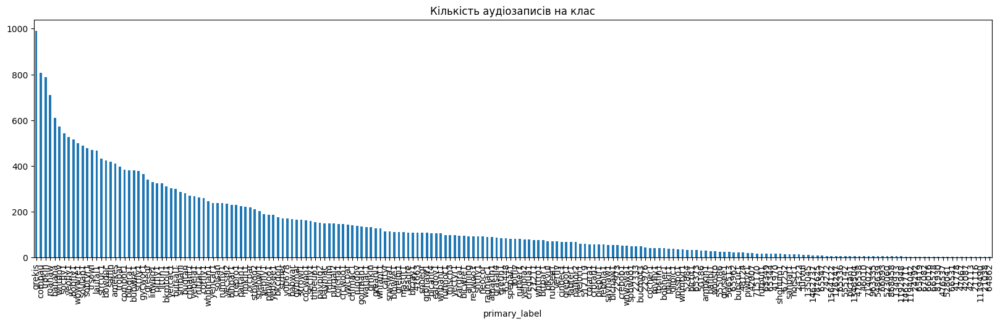

In [56]:
train_df["primary_label"].value_counts().plot(kind='bar', figsize=(20,5), title="Кількість аудіозаписів на клас")

/home/artur/files/Audio Processing/Audio_Processing_Labs/Lab3/venv/lib/python3.10/site-packages/pyloudnorm/normalize.py:62: UserWarning: Possible clipped samples in output.
  warnings.warn("Possible clipped samples in output.")


32000
3702928 (3702928,)
# Audio:


# Visualization:


/tmp/ipykernel_531034/3186847370.py:79: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


cc-by-nc-sa 4.0
CSA


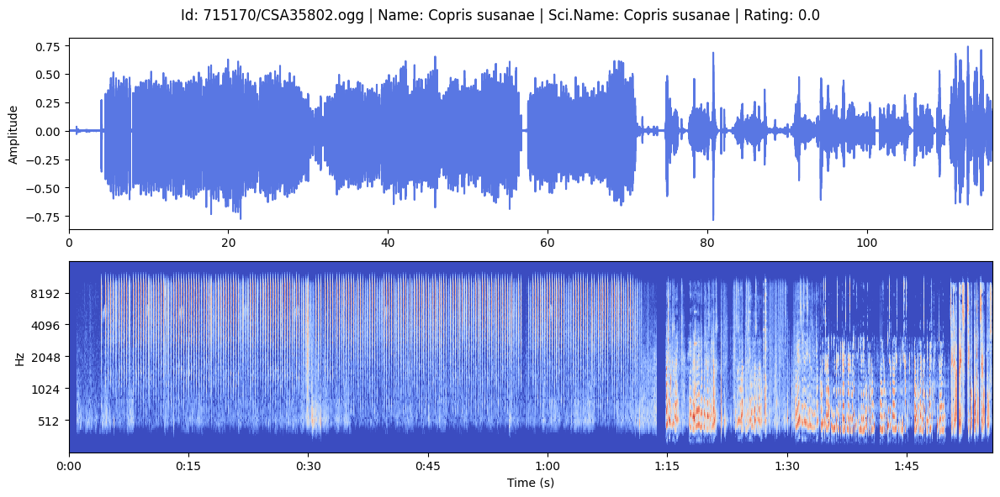

In [57]:
idx = 890

display_audio(train_df.iloc[idx], LUFS=-18, filtering=True)
print(train_df.iloc[idx]["license"])
print(train_df.iloc[idx]["collection"])

/tmp/ipykernel_531034/3681754576.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  row['filepath'] = "./birdclef-2025/train_soundscapes/H02_20230421_170000.ogg"


32000
1920000 (1920000,)
# Audio:


# Visualization:


/tmp/ipykernel_531034/3186847370.py:79: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


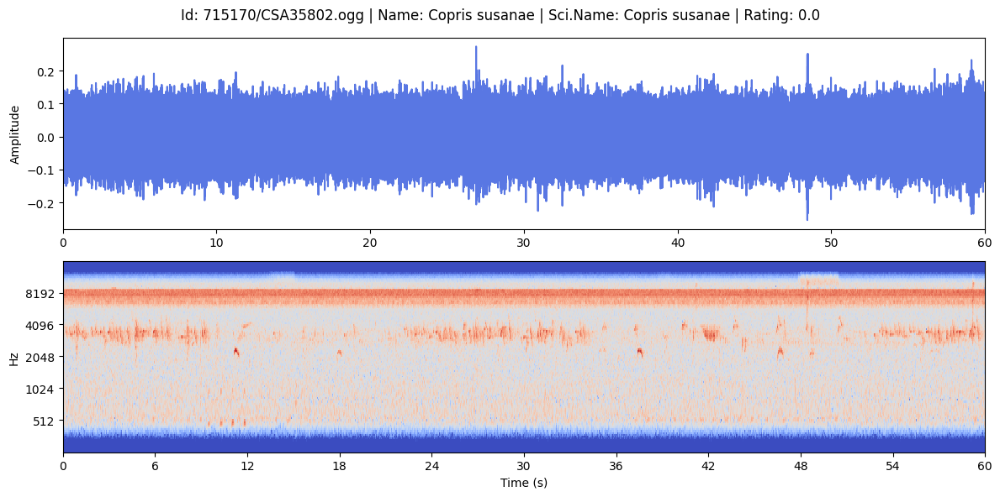

In [58]:
row = train_df.iloc[idx]
row['filepath'] = "./birdclef-2025/train_soundscapes/H02_20230421_170000.ogg"
display_audio(row, LUFS=-24.0, filtering=True)

32000
3089207 (3089207,)
# Audio:


# Visualization:


/tmp/ipykernel_531034/3186847370.py:79: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


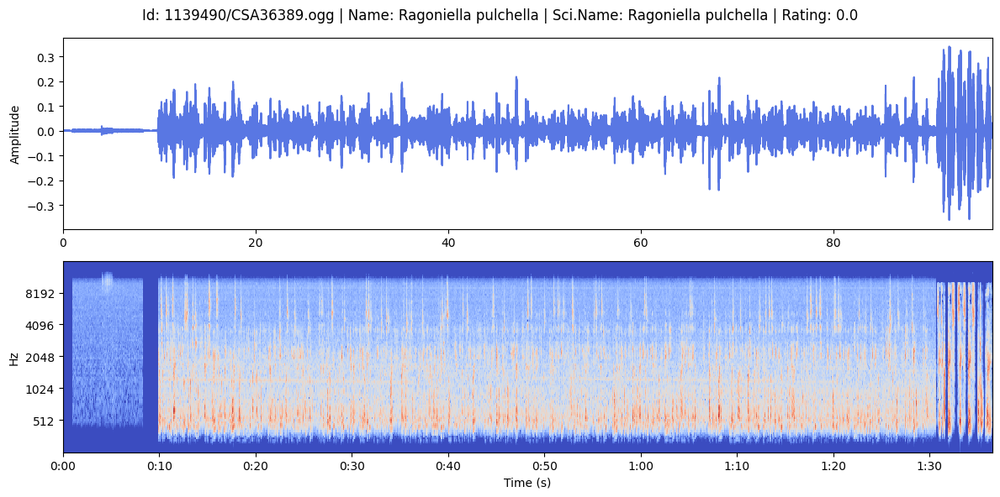

In [59]:
display_audio(train_df.iloc[1], LUFS=-24.0, filtering=True)

32000
517007 (517007,)
# Audio:


# Visualization:


/tmp/ipykernel_531034/3186847370.py:79: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


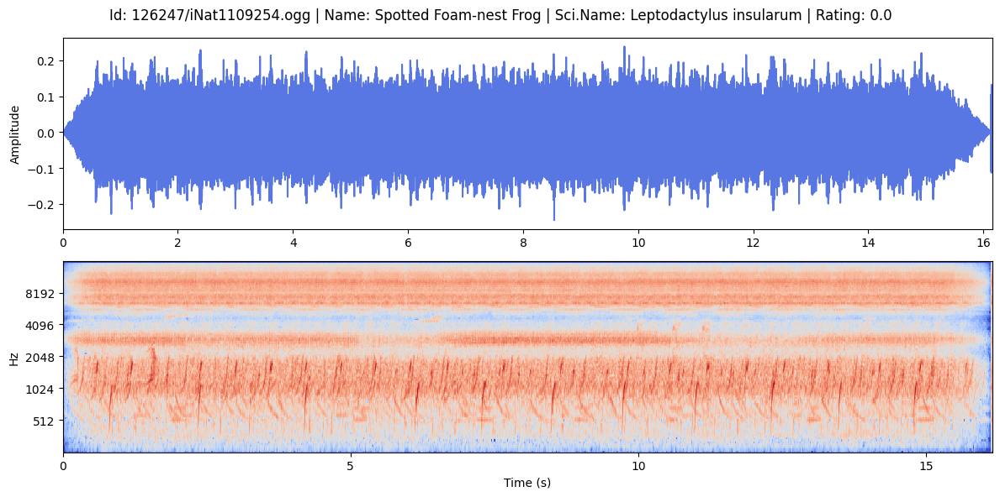

In [60]:
display_audio(train_df.iloc[10], LUFS=-24.0)

32000
4318034 (4318034,)
# Audio:


# Visualization:


/tmp/ipykernel_531034/3186847370.py:79: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


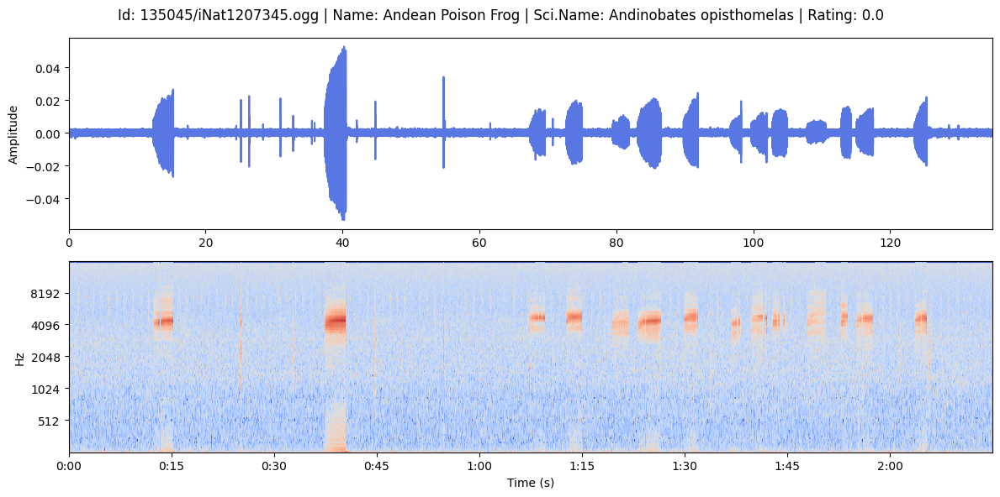

In [61]:
display_audio(train_df.iloc[25])

# Dataset

In [19]:
spectrogram_df = get_spec_df(train_df)
spectrogram_df.to_pickle("./mel_dataset.pkl")

100%|██████████| 28564/28564 [36:49<00:00, 12.93it/s]  


In [16]:
spectrogram_df = pd.read_pickle("./mel_dataset.pkl")

In [17]:
spectrogram_df

,primary_label,secondary_labels,filepath,mel_spec
0,1139490,[''],./birdclef-2025/train_audio/1139490/CSA36385.ogg,"[[0.7787854, 0.72680044, 0.7371131, 0.75335705..."
1,1139490,[''],./birdclef-2025/train_audio/1139490/CSA36389.ogg,"[[0.7748856, 0.7089893, 0.7117479, 0.7041996, ..."
2,1192948,[''],./birdclef-2025/train_audio/1192948/CSA36358.ogg,"[[0.5049974, 0.5580171, 0.6113227, 0.6229706, ..."
3,1192948,[''],./birdclef-2025/train_audio/1192948/CSA36366.ogg,"[[0.7535102, 0.6929836, 0.7101771, 0.73020065,..."
4,1192948,[''],./birdclef-2025/train_audio/1192948/CSA36373.ogg,"[[0.6351748, 0.6099719, 0.6986872, 0.7212432, ..."
...,...,...,...,...
28559,ywcpar,[''],./birdclef-2025/train_audio/ywcpar/iNat77392.ogg,"[[0.7831712, 0.86758465, 0.8752326, 0.9021169,..."
28560,ywcpar,[''],./birdclef-2025/train_audio/ywcpar/iNat78624.ogg,"[[0.72351384, 0.7583494, 0.8453201, 0.7774927,..."
28561,ywcpar,[''],./birdclef-2025/train_audio/ywcpar/iNat789234.ogg,"[[0.79194343, 0.8217498, 0.8507201, 0.8341698,..."
28562,ywcpar,[''],./birdclef-2025/train_audio/ywcpar/iNat819873.ogg,"[[0.8273054, 0.8813476, 0.8827979, 0.820447, 0..."


In [18]:
class DatasetCLEF(Dataset):
    def __init__(self, df, train=True):
        self.df = df.reset_index(drop=True)
        self.train = train

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        item = self.df.iloc[idx]

        mel_spec = torch.tensor(item["mel_spec"]).unsqueeze(0)

        if self.train:
            if random.uniform(0, 1) < 0.5:
                mel_spec = FrequencyMasking(freq_mask_param=40)(mel_spec)
            if random.uniform(0, 1) < 0.5:
                mel_spec = TimeMasking(time_mask_param=40)(mel_spec)
            
        secondary = eval(item["secondary_labels"])
        all_labels = [item["primary_label"]] + secondary
        indices = [CFG.name2label[label] for label in all_labels if label in CFG.name2label]

        target = np.zeros(len(CFG.name2label), dtype=np.float32)
        target[indices] = 1.0
        target = torch.tensor(target)

        return mel_spec, target

In [19]:
class EfficientNet(nn.Module):
    def __init__(self, num_classes: int = 1, depth: int = 0, infer_mode: bool = False, pretrained: bool = False):
        super().__init__()
        depth_models = {
            0: models.efficientnet_b0,
            1: models.efficientnet_b1,
            2: models.efficientnet_b2,
            3: models.efficientnet_b3,
            4: models.efficientnet_b4,
            5: models.efficientnet_b5,
            6: models.efficientnet_b6,
            7: models.efficientnet_b7,
        }

        self.infer_mode = infer_mode
        self.base_model = depth_models[depth](pretrained = pretrained)

        head_in_features = self.base_model.classifier[1].in_features
        self.base_model.classifier = nn.Sequential(
            nn.Linear(head_in_features, 1024),
            nn.ReLU(),
            nn.BatchNorm1d(1024),
            nn.Dropout(p=0.3),
            nn.Linear(1024, num_classes)
        )


    def forward(self, x):
        if x.shape[1] == 1:
            x = x.repeat(1, 3, 1, 1)

        x = self.base_model(x)
        if self.infer_mode:
            x = torch.softmax(x, dim=1)
        return x


In [20]:
model = EfficientNet(num_classes=len(CFG.name2label), depth=0).to(CFG.device)

/home/artur/files/Audio Processing/Audio_Processing_Labs/Lab3/venv/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/artur/files/Audio Processing/Audio_Processing_Labs/Lab3/venv/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


In [21]:
model

EfficientNet(
  (base_model): EfficientNet(
    (features): Sequential(
      (0): Conv2dNormActivation(
        (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): SiLU(inplace=True)
      )
      (1): Sequential(
        (0): MBConv(
          (block): Sequential(
            (0): Conv2dNormActivation(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
              (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
              (2): SiLU(inplace=True)
            )
            (1): SqueezeExcitation(
              (avgpool): AdaptiveAvgPool2d(output_size=1)
              (fc1): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
              (fc2): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
              (activation): SiLU(inplace=True)
              (sca

In [22]:
spectrogram_df

,primary_label,secondary_labels,filepath,mel_spec
0,1139490,[''],./birdclef-2025/train_audio/1139490/CSA36385.ogg,"[[0.7787854, 0.72680044, 0.7371131, 0.75335705..."
1,1139490,[''],./birdclef-2025/train_audio/1139490/CSA36389.ogg,"[[0.7748856, 0.7089893, 0.7117479, 0.7041996, ..."
2,1192948,[''],./birdclef-2025/train_audio/1192948/CSA36358.ogg,"[[0.5049974, 0.5580171, 0.6113227, 0.6229706, ..."
3,1192948,[''],./birdclef-2025/train_audio/1192948/CSA36366.ogg,"[[0.7535102, 0.6929836, 0.7101771, 0.73020065,..."
4,1192948,[''],./birdclef-2025/train_audio/1192948/CSA36373.ogg,"[[0.6351748, 0.6099719, 0.6986872, 0.7212432, ..."
...,...,...,...,...
28559,ywcpar,[''],./birdclef-2025/train_audio/ywcpar/iNat77392.ogg,"[[0.7831712, 0.86758465, 0.8752326, 0.9021169,..."
28560,ywcpar,[''],./birdclef-2025/train_audio/ywcpar/iNat78624.ogg,"[[0.72351384, 0.7583494, 0.8453201, 0.7774927,..."
28561,ywcpar,[''],./birdclef-2025/train_audio/ywcpar/iNat789234.ogg,"[[0.79194343, 0.8217498, 0.8507201, 0.8341698,..."
28562,ywcpar,[''],./birdclef-2025/train_audio/ywcpar/iNat819873.ogg,"[[0.8273054, 0.8813476, 0.8827979, 0.820447, 0..."


In [23]:
train_ind = random.sample(range(spectrogram_df.shape[0]), int(float(spectrogram_df.shape[0]) * 0.8))
train_df = spectrogram_df.iloc[train_ind].sort_index()
val_df   = spectrogram_df[~spectrogram_df['filepath'].isin(train_df['filepath'])].copy()

del spectrogram_df

In [24]:
train_df

,primary_label,secondary_labels,filepath,mel_spec
0,1139490,[''],./birdclef-2025/train_audio/1139490/CSA36385.ogg,"[[0.7787854, 0.72680044, 0.7371131, 0.75335705..."
1,1139490,[''],./birdclef-2025/train_audio/1139490/CSA36389.ogg,"[[0.7748856, 0.7089893, 0.7117479, 0.7041996, ..."
2,1192948,[''],./birdclef-2025/train_audio/1192948/CSA36358.ogg,"[[0.5049974, 0.5580171, 0.6113227, 0.6229706, ..."
3,1192948,[''],./birdclef-2025/train_audio/1192948/CSA36366.ogg,"[[0.7535102, 0.6929836, 0.7101771, 0.73020065,..."
4,1192948,[''],./birdclef-2025/train_audio/1192948/CSA36373.ogg,"[[0.6351748, 0.6099719, 0.6986872, 0.7212432, ..."
...,...,...,...,...
28557,ywcpar,[''],./birdclef-2025/train_audio/ywcpar/iNat681523.ogg,"[[0.81881523, 0.92470944, 0.87632585, 0.908176..."
28558,ywcpar,[''],./birdclef-2025/train_audio/ywcpar/iNat742782.ogg,"[[0.89730245, 0.8945114, 0.8216327, 0.8515549,..."
28559,ywcpar,[''],./birdclef-2025/train_audio/ywcpar/iNat77392.ogg,"[[0.7831712, 0.86758465, 0.8752326, 0.9021169,..."
28561,ywcpar,[''],./birdclef-2025/train_audio/ywcpar/iNat789234.ogg,"[[0.79194343, 0.8217498, 0.8507201, 0.8341698,..."


In [25]:
val_df

,primary_label,secondary_labels,filepath,mel_spec
13,126247,[''],./birdclef-2025/train_audio/126247/iNat888527.ogg,"[[0.88301235, 0.9791511, 0.9142332, 0.9305121,..."
24,135045,[''],./birdclef-2025/train_audio/135045/iNat1122209...,"[[0.61339414, 0.6063573, 0.541071, 0.47354323,..."
29,135045,[''],./birdclef-2025/train_audio/135045/iNat1208551...,"[[0.0507419, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0..."
39,1462737,[''],./birdclef-2025/train_audio/1462737/CSA36380.ogg,"[[0.7624086, 0.74621487, 0.69028044, 0.6449441..."
50,21038,[''],./birdclef-2025/train_audio/21038/iNat297879.ogg,"[[0.44742107, 0.41617954, 0.32565513, 0.235123..."
...,...,...,...,...
28549,ywcpar,[''],./birdclef-2025/train_audio/ywcpar/iNat370911.ogg,"[[0.5935586, 0.7163926, 0.71804285, 0.7454798,..."
28553,ywcpar,[''],./birdclef-2025/train_audio/ywcpar/iNat51530.ogg,"[[0.32561514, 0.28515652, 0.18707085, 0.168218..."
28554,ywcpar,[''],./birdclef-2025/train_audio/ywcpar/iNat612649.ogg,"[[0.57866365, 0.76692843, 0.7593565, 0.7087374..."
28560,ywcpar,[''],./birdclef-2025/train_audio/ywcpar/iNat78624.ogg,"[[0.72351384, 0.7583494, 0.8453201, 0.7774927,..."


In [26]:
train_dataset = DatasetCLEF(train_df, train=True)
val_dataset = DatasetCLEF(val_df, train=False)

train_loader = DataLoader(train_dataset, batch_size=CFG.batch_size, shuffle=True, num_workers=4, pin_memory=True)
val_loader = DataLoader(val_dataset, batch_size=1, shuffle=False, num_workers=4, pin_memory=True)

In [27]:
model = EfficientNet(num_classes=len(CFG.name2label), pretrained=True).to(CFG.device)

criterion = nn.BCEWithLogitsLoss()
optimizer = optim.AdamW(model.parameters(), lr=1e-4)
scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=10)

/home/artur/files/Audio Processing/Audio_Processing_Labs/Lab3/venv/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/artur/files/Audio Processing/Audio_Processing_Labs/Lab3/venv/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_B0_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B0_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [ ]:
best_val_loss = float('inf')
for epoch in range(1, CFG.epochs + 1):
    print(f"\nEpoch {epoch}")

    model.train()
    train_loss = 0
    for mel, target in tqdm(train_loader, desc="Training", leave=False):
        mel = mel.to(CFG.device)
        target = target.to(CFG.device)

        optimizer.zero_grad()
        logits = model(mel)
        loss = criterion(logits, target)
        loss.backward()
        optimizer.step()

        train_loss += loss.item() * mel.size(0)

    avg_train_loss = train_loss / len(train_loader.dataset)

    model.eval()
    val_loss = 0
    with torch.no_grad():
        for mel, target in tqdm(val_loader, desc="Validation", leave=False):
            mel = mel.to(CFG.device)
            target = target.to(CFG.device)

            logits = model(mel)
            loss = criterion(logits, target)
            val_loss += loss.item() * mel.size(0)

    avg_val_loss = val_loss / len(val_loader.dataset)

    print(f"Train Loss: {avg_train_loss:.4f} | Val Loss: {avg_val_loss:.4f}")

    scheduler.step()

    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        torch.save(model.state_dict(), f"efficientnetb0.pth")
        print(f"Saved efficientnetb0.pth")

/home/artur/files/Audio Processing/Audio_Processing_Labs/Lab3/venv/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/artur/files/Audio Processing/Audio_Processing_Labs/Lab3/venv/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_B0_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B0_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)



Epoch 1


Train Loss: 0.5247 | Val Loss: 0.1844
Saved efficientnetb0.pth

Epoch 2


Train Loss: 0.0889 | Val Loss: 0.0464
Saved efficientnetb0.pth

Epoch 3


Train Loss: 0.0402 | Val Loss: 0.0336
Saved efficientnetb0.pth

Epoch 4


Train Loss: 0.0342 | Val Loss: 0.0324
Saved efficientnetb0.pth

Epoch 5


Train Loss: 0.0315 | Val Loss: 0.0309
Saved efficientnetb0.pth

Epoch 6


Train Loss: 0.0294 | Val Loss: 0.0280
Saved efficientnetb0.pth

Epoch 7


Train Loss: 0.0278 | Val Loss: 0.0268
Saved efficientnetb0.pth

Epoch 8


Train Loss: 0.0268 | Val Loss: 0.0280

Epoch 9


Train Loss: 0.0262 | Val Loss: 0.0259
Saved efficientnetb0.pth

Epoch 10


Train Loss: 0.0260 | Val Loss: 0.0252
Saved efficientnetb0.pth

Epoch 11


Train Loss: 0.0259 | Val Loss: 0.0266

Epoch 12


Train Loss: 0.0258 | Val Loss: 0.0258

Epoch 13


Train Loss: 0.0256 | Val Loss: 0.0243
Saved efficientnetb0.pth

Epoch 14


Train Loss: 0.0252 | Val Loss: 0.0274

Epoch 15


Train Loss: 0.0243 | Val Loss: 0.0231
Saved efficientnetb0.pth

Epoch 16


Train Loss: 0.0230 | Val Loss: 0.0506

Epoch 17


Train Loss: 0.0216 | Val Loss: 0.0229
Saved efficientnetb0.pth

Epoch 18


Train Loss: 0.0204 | Val Loss: 0.0189
Saved efficientnetb0.pth

Epoch 19


Train Loss: 0.0192 | Val Loss: 0.0203

Epoch 20


Train Loss: 0.0181 | Val Loss: 0.0237

Epoch 21


Train Loss: 0.0170 | Val Loss: 0.0185
Saved efficientnetb0.pth

Epoch 22


Train Loss: 0.0163 | Val Loss: 0.0192

Epoch 23


Train Loss: 0.0154 | Val Loss: 0.0170
Saved efficientnetb0.pth

Epoch 24


Train Loss: 0.0142 | Val Loss: 0.0178

Epoch 25


Train Loss: 0.0134 | Val Loss: 0.0164
Saved efficientnetb0.pth


# Test

In [28]:
model = EfficientNet(num_classes=len(CFG.name2label))
model.load_state_dict(torch.load("./weights/efficientnetb0.pth", map_location=CFG.device))
model.to(CFG.device)
model.eval()

/home/artur/files/Audio Processing/Audio_Processing_Labs/Lab3/venv/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/artur/files/Audio Processing/Audio_Processing_Labs/Lab3/venv/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


EfficientNet(
  (base_model): EfficientNet(
    (features): Sequential(
      (0): Conv2dNormActivation(
        (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): SiLU(inplace=True)
      )
      (1): Sequential(
        (0): MBConv(
          (block): Sequential(
            (0): Conv2dNormActivation(
              (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
              (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
              (2): SiLU(inplace=True)
            )
            (1): SqueezeExcitation(
              (avgpool): AdaptiveAvgPool2d(output_size=1)
              (fc1): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
              (fc2): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
              (activation): SiLU(inplace=True)
              (sca

In [36]:
res_columns = ["row_id"] + [CFG.label2name[label] for label in range(206)]
submission = pd.DataFrame(columns=res_columns)

In [40]:
train_paths = [path for path in train_df["filepath"]]
random.shuffle(train_paths)

In [42]:
predictions = pd.DataFrame(columns=["row_id"] + CFG.class_labels)

for path in tqdm(train_paths[:50]):
    mels = process_audio_file_chunks(path)

    for i, mel in enumerate(mels):
        row_id = os.path.basename(path).split('.')[0] + f"_{(i+1)*5}"
        input_tensor = torch.tensor(mel, dtype=torch.float32).unsqueeze(0).unsqueeze(0).to(CFG.device)  

        with torch.no_grad():
            logits = model(input_tensor)[0]
            probs = F.softmax(logits, dim=0).cpu().numpy().tolist()

        row = pd.DataFrame([[row_id] + probs], columns=["row_id"] + CFG.class_labels)
        predictions = pd.concat([predictions, row], ignore_index=True)

sample_submission = pd.read_csv(CFG.submission_csv)
predictions.to_csv("submission.csv", index=False, float_format="%.16f")

  0%|          | 0/50 [00:00<?, ?it/s]/tmp/ipykernel_531034/1042894555.py:15: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  predictions = pd.concat([predictions, row], ignore_index=True)
100%|██████████| 50/50 [00:16<00:00,  3.04it/s]


In [43]:
predictions

,row_id,0,1,2,3,4,5,6,7,8,...,196,197,198,199,200,201,202,203,204,205
0,iNat744348_5,1.522006e-07,1.147499e-06,2.374559e-07,2.023525e-06,1.378341e-06,5.207381e-06,0.000004,1.543919e-06,3.396072e-06,...,7.205200e-05,5.589421e-05,5.148706e-05,3.479606e-06,1.887163e-05,6.108096e-04,3.638969e-05,2.131324e-05,1.024189e-03,2.607028e-02
1,iNat744348_10,3.012854e-06,1.869551e-05,4.623802e-06,1.201950e-05,1.313483e-05,4.045350e-05,0.000029,1.424432e-05,2.599578e-05,...,1.202105e-04,3.088637e-04,1.359838e-04,5.315139e-05,5.825760e-05,2.634918e-03,1.082352e-04,2.471022e-04,4.051769e-04,1.201228e-01
2,iNat744348_15,9.991464e-08,5.507299e-07,8.195758e-08,2.758674e-07,6.041891e-07,2.843865e-06,0.000002,5.772243e-07,9.711938e-07,...,1.403083e-05,2.606791e-05,5.563886e-05,3.728688e-06,8.705872e-06,1.637310e-03,5.195589e-06,7.437578e-06,2.601955e-05,7.056274e-03
3,iNat744348_20,2.215535e-19,2.157028e-12,3.122750e-18,6.768704e-22,6.822351e-26,6.093764e-19,0.000003,2.084443e-17,3.623500e-20,...,1.055604e-12,4.367137e-11,3.415458e-11,9.348110e-11,4.450363e-13,1.462448e-07,1.217651e-08,2.742009e-09,2.390649e-07,5.142790e-08
4,XC250411_5,2.523724e-07,3.993478e-07,3.688098e-07,1.021616e-06,6.247944e-07,1.518819e-06,0.000004,2.047150e-07,5.359513e-07,...,2.090986e-05,1.385247e-03,3.905951e-04,3.693404e-06,2.551128e-05,9.153663e-07,1.669494e-05,1.137672e-05,2.719118e-06,1.992126e-06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
364,XC694486_10,9.669156e-06,6.535023e-05,1.403634e-05,7.372115e-04,1.095918e-04,1.400802e-04,0.000056,7.057835e-05,3.258679e-05,...,1.879912e-04,9.493407e-05,8.645870e-03,2.822122e-04,8.923315e-04,2.639151e-04,2.301976e-04,3.151549e-04,4.173357e-03,1.469471e-03
365,XC694486_15,2.876176e-05,1.446775e-04,4.372039e-05,7.301695e-04,2.324149e-04,4.708326e-04,0.000083,1.683692e-04,1.196056e-04,...,5.418046e-04,9.298560e-05,4.094774e-03,1.909641e-04,7.324711e-04,5.411158e-04,2.242947e-04,1.460624e-03,1.953163e-03,3.768329e-03
366,XC694486_20,4.341784e-06,1.499484e-05,5.859070e-06,4.822681e-04,5.405359e-05,5.293504e-05,0.000023,2.036601e-05,1.015638e-05,...,8.172152e-05,3.549528e-05,2.113844e-03,1.143692e-04,2.283942e-04,5.536461e-05,4.723008e-05,1.900218e-04,1.155050e-03,1.382904e-03
367,XC694486_25,9.709731e-07,5.627657e-06,1.773671e-06,2.941421e-04,1.351647e-05,1.706794e-05,0.000009,6.990507e-06,2.483720e-06,...,4.654619e-05,1.899666e-05,6.387726e-04,8.228605e-05,1.011922e-04,7.950393e-05,1.547604e-05,1.290999e-04,2.786242e-03,8.216075e-04


https://www.kaggle.com/code/pelcharskyi/ucu-kpi-audio-processing-hw3?scriptVersionId=240552467